In [1]:
import dac
from pathlib import Path
from audiotools import AudioSignal
import IPython.display as ipd

In [2]:
root_dir = Path.home() / 'userdata'

In [3]:
save_dir = Path('dac_quality_experiments_outputs')
save_dir.mkdir(parents=True, exist_ok=True)

In [7]:
# SQDAC9
model_dir = root_dir / "sake/descript-audio-codec_latent-score/sqdac/dac/package.pth"
model = dac.DAC.load(model_dir)
model = model.to('cuda')

In [8]:
# SQDAC4
n_model_dir = root_dir / "sake/descript-audio-codec_latent-score/sqdac/dac/package.pth"
n_model = dac.DAC.load(n_model_dir)
n_model = n_model.to('cuda')

In [5]:
# Pretrained
p_model_dir = dac.utils.download(model_type="44khz")
p_model = dac.DAC.load(p_model_dir)
p_model = p_model.to('cuda')

/home/sake/.local/share/virtualenvs/descript-audio-codec_latent-score-N8eTRKuL/lib/python3.10/site-packages/torch/nn/utils/weight_norm.py:28: UserWarning: torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.
  warnings.warn("torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.")


In [6]:
audio_dir = root_dir / "latent_score_dataset/string_quartet/segments/franz_schubert/VpdS2rwMz1M/audio/original/VpdS2rwMz1M:0006:141.4413:169.63613333333333.wav"
signal = AudioSignal(audio_dir)
signal = signal.to_mono()

In [19]:
codes = model.compress(signal)
n_codes = n_model.compress(signal)
p_codes = p_model.compress(signal)

In [9]:
# Trained model : Codes
codes

DACFile(codes=tensor([[[394, 394, 394,  ..., 394, 394, 394],
         [508, 508, 508,  ..., 508, 508, 508],
         [919, 919, 919,  ..., 919, 919, 919],
         ...,
         [456, 456, 456,  ..., 456, 456, 456],
         [173, 173, 808,  ..., 173, 173, 173],
         [440, 440, 440,  ..., 440, 440, 440]]]), chunk_length=72, original_length=1243392, input_db=tensor([-28.3437]), channels=1, sample_rate=44100, padding=False, dac_version='1.0.0')

In [24]:
codes.codes[...,:10]

tensor([[[ 394,  394,  394,  394,  394,   44,   44,  485,  982,  463],
         [ 508,  508,  508,  508,  508,  508,  486,   75,  933,  333],
         [ 919,  919,  919,  919,  919,  919,  919,  428,  859,   22],
         [ 999,  999,  999,  841,  961,  449,  210,  229,  111,  770],
         [ 635,  635,  635,  504,  581,  568,  728,  130, 1001,  618],
         [ 802,  802,  824,  802,  802,  350,  409,  794,  110,  193],
         [ 456,  456,  456,  434,  456,  997,  525,  427,  548,  228],
         [ 173,  173,  808,    7,  156,  123,  769,  153,  465,  738],
         [ 440,  440,  440,  452,  123,  322,  780,  188,  982,  201]]])

In [10]:
trained_decoded = model.decompress(codes)
trained_4_codes_decoded = model.decompress(codes, n_quantizers=4)

In [16]:
sqdac4_decoded = n_model.decompress(n_codes)

In [20]:
pretrained_decoded = p_model.decompress(p_codes)
pretrained_4_codes_decoded = p_model.decompress(p_codes, n_quantizers=4)

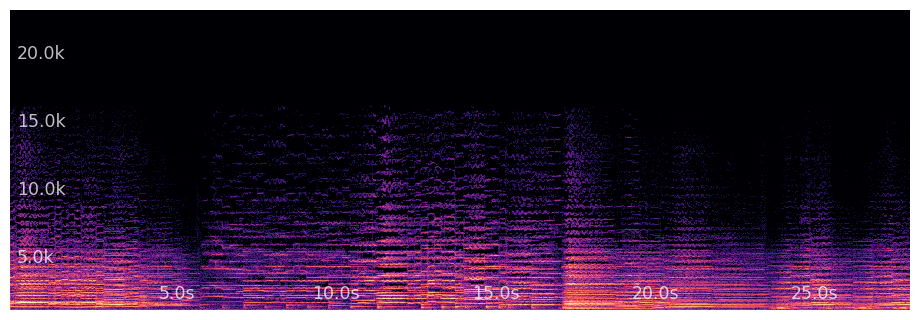

In [12]:
# Original mono signal
signal.specshow()
ipd.Audio(signal.numpy().squeeze(), rate=44100)

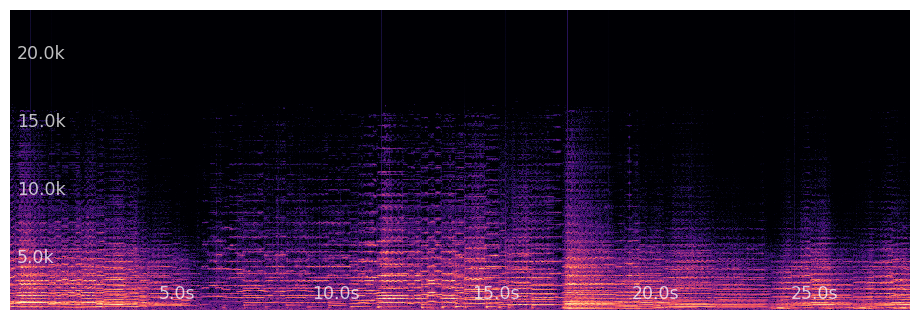

In [17]:
# Trained model: decoded
trained_decoded.specshow()
ipd.Audio(trained_decoded.numpy().squeeze(), rate=44100)

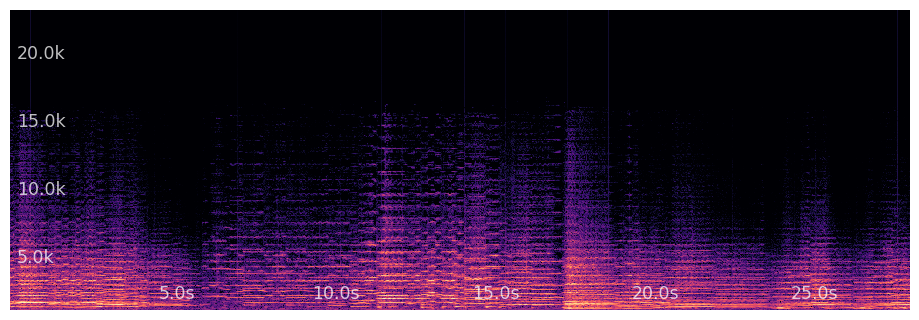

In [15]:
# Trained model: only 4 codes decoded
trained_4_codes_decoded.specshow()
ipd.Audio(trained_4_codes_decoded.numpy().squeeze(), rate=44100)

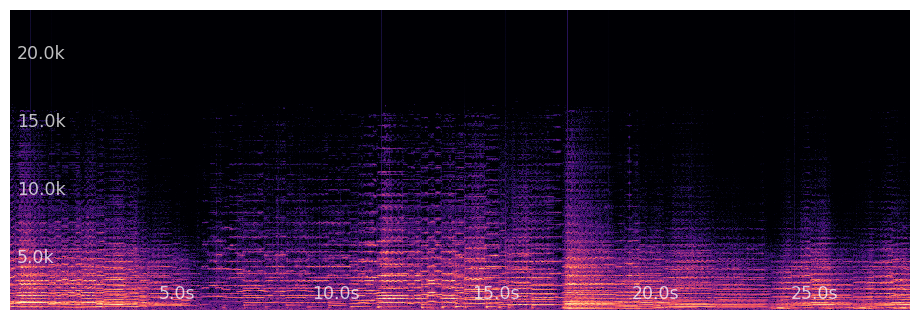

In [18]:
# SQDAC4: decoded
sqdac4_decoded.specshow()
ipd.Audio(sqdac4_decoded.numpy().squeeze(), rate=44100)

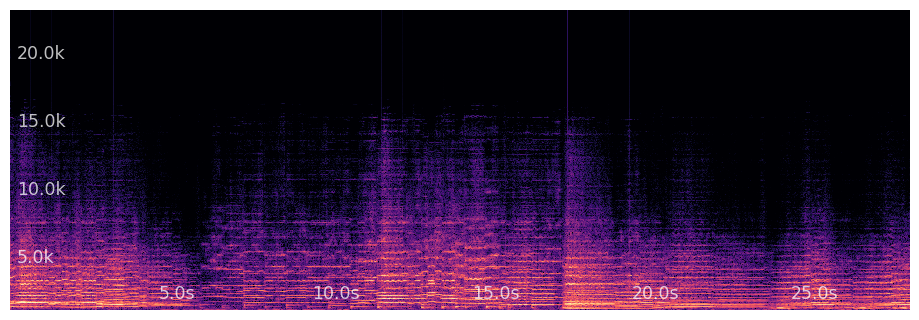

In [21]:
# Pretrained model: decoded
pretrained_decoded.specshow()
ipd.Audio(pretrained_decoded.numpy().squeeze(), rate=44100)

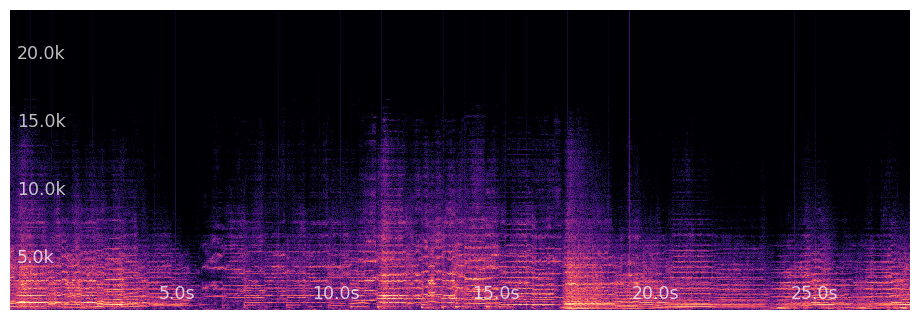

In [22]:
# Pretrained model: only 4 codes decoded
pretrained_4_codes_decoded.specshow()
ipd.Audio(pretrained_4_codes_decoded.numpy().squeeze(), rate=44100)

In [ ]:
audio_dir.stem

In [ ]:
# Save files
signal.write(save_dir / f"{audio_dir.stem}_original.wav")
trained_decoded.write(save_dir / f"{audio_dir.stem}_trained_decoded.wav")
trained_4_codes_decoded.write(save_dir / f"{audio_dir.stem}_trained_4_codes_decoded.wav")
pretrained_decoded.write(save_dir / f"{audio_dir.stem}_pretrained_decoded.wav")
pretrained_4_codes_decoded.write(save_dir / f"{audio_dir.stem}_pretrained_4_codes_decoded.wav")